<a href="https://colab.research.google.com/github/YichengShen/cis5810-project/blob/main/style_transfer_v0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Style Transfer of Images and Videos**

## **Section 1: Configuration**

In [ ]:
#------------------General Configs---------------------------------------------#
# Mode (IMPORTANT: Make sure you are on the correct mode!)
# 3 modes: 'TRAIN', 'IMAGE', 'VIDEO'
# >>> 1. use 'TRAIN' to learn weights of a particular style
# >>> 2. use 'IMAGE' to transfrom a image using existing transformation weights
# >>> 3. use 'VIDEO' to transfrom a video using existing transformation weights
MODE = 'VIDEO'

# Paths
ROOT = '/content/drive/MyDrive/style_transfer' # Project root path in Google Drive
CONTENT_IMAGE_DIR = 'images/content_images' # Directory of content images in Google Drive
STYLE_IMAGE_DIR = 'images/style_images' # Directory of style images in Google Drive
RESULT_IMAGE_DIR = 'images/result_images' # Directory of result images in Google Drive
TRANSFORMATIONS_DIR = 'trained_transformations' # Directory of saved transformation weights in Google Drive
CONTENT_VIDEO_DIR = 'videos/content_videos' # Directory of content videos in Google Drive
RESULT_VIDEO_DIR = 'videos/result_videos' # Directory of result videos in Google Drive

# Random seed
SEED = 0
#------------------------------------------------------------------------------#

#------------------Training Configs--------------------------------------------#
CONTINUE_FROM_PREVIOUS_WEIGHTS = False # If False, train a fresh model
PREVIOUS_WEIGHTS_PATH = '/content/drive/MyDrive/style_transfer/training_checkpoints/workshop_20221125_1669397153/model_checkpoints/workshop_checkpoint_6000.pth'
STYLE_IMAGE_NAME = 'miro.jpg' # Filename of style image
CONTENT_WEIGHT = 8
STYLE_WEIGHT = 66
TRAIN_IMAGE_SIZE = 256
NUM_EPOCHS = 1
TRAIN_BATCH_SIZE = 4 
ADAM_LR = 0.001
SAVE_MODEL_EVERY = 500
CHECKPOINT_DIR = "training_checkpoints" # Directory in Google Drive where checkpoints are saved
DATASET_PATH = '/content/train_data' # Path where training data is stored (DO NOT CHANGE)
LOSS_NETWORK_PATH = '/content/pretrained_loss_network' # Path of pretrained loss network weights (DO NOT CHANGE)
#------------------------------------------------------------------------------#

#------------------Image Style Transfer Configs--------------------------------#
CONTENT_IMAGE_NAME = 'philly.jpg' # Filename of input content image
RESULT_IMAGE_NAME = 'philly_wave_transformed' # The output image's filename is generated according to this
TRANSFORMATION_WEIGHTS = 'wave_weights.pth' # Filename of pretrained transformation (style) weights
#------------------------------------------------------------------------------#

#------------------Video Style Transfer Configs--------------------------------#
CONTENT_VIDEO_NAME = "lishui.mp4" # Filename of input content video
RESULT_VIDEO_NAME = "lishui_miro_transformed" # The output video's filename is generated according to this
TRANSFORMATION_WEIGHTS = "miro_weights.pth" # Filename of pretrained transformation (style) weights
BATCH_SIZE = 2 # Increase if you have larger GPU RAM
CONTENT_FRAMES_DATASET_DIR = "/content/video_processing/extracted_frames" # (DO NOT CHANGE)
CONTENT_FRAMES_DIR = "/content/video_processing/extracted_frames/content_frames" # (DO NOT CHANGE)
STYLE_FRAMES_SAVING_PATH = "/content/video_processing/style_frames" # (DO NOT CHANGE)
#------------------------------------------------------------------------------#

## **Section 2: Setup**


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Create directories**

In [ ]:
%cd /content
# Video style transfer directories
!mkdir -p video_processing/extracted_frames/content_frames
!mkdir -p video_processing/style_frames

/content


**Download dataset and VGG16 pretrained weights**

The downloads are only required for the training part. Style tranfer using existing pretrained weights does not need the downloaded contents.

In [ ]:
if MODE == 'TRAIN':
    sh = """
    echo 'Downloading training dataset...'
    cd /content
    wget -nc http://images.cocodataset.org/zips/train2017.zip
    mkdir -p train_data
    unzip -n -qq train2017.zip -d train_data
    rm train2017.zip
    echo 'Downloading VGG16 pretrained weights...'
    cd /content
    mkdir -p pretrained_loss_network
    cd pretrained_loss_network
    wget -nc https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
    """
else: 
    sh = """
    echo 'Download skipped'
    """

with open('download_script.sh', 'w') as file:
    file.write(sh)

!bash download_script.sh

--2022-11-26 23:19:52--  http://images.cocodataset.org/zips/train2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 54.231.224.233, 52.217.132.105, 54.231.136.193, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|54.231.224.233|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 19336861798 (18G) [application/zip]
Saving to: ‘train2017.zip’

train2017.zip       100%[===================>]  18.01G  45.3MB/s    in 7m 18s  

2022-11-26 23:27:10 (42.1 MB/s) - ‘train2017.zip’ saved [19336861798/19336861798]

--2022-11-26 23:29:50--  https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
Resolving web.eecs.umich.edu (web.eecs.umich.edu)... 141.212.113.214
Connecting to web.eecs.umich.edu (web.eecs.umich.edu)|141.212.113.214|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 553451520 (528M) [application/x-tar]
Saving to: ‘vgg16-00b39a1b.pth’

vgg16-00b39a1b.pth  100%[===================>] 527.81M  55.3MB/s

**Import libraries**

In [ ]:
import os
import time
from datetime import datetime
import gc
import natsort

# Files
from google.colab import files

import numpy as np
import pandas as pd

# Plot
import matplotlib.pyplot as plt
import seaborn as sns

# Image
from PIL import Image

import cv2

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from torchvision import transforms, datasets
import torchvision.models as models

from torchsummary import summary

**Set seed for random operations**

In [ ]:
np.random.seed(SEED)
torch.manual_seed(SEED)

**Set GPU**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Running on:", device)

Running on: cuda


## **Section 3: Helper Functions**

### **Loading, saving, and showing images**

In [ ]:
# Load image file
def load_image(path):
    # Images loaded as BGR
    image = cv2.imread(path)
    return image

# Preprocess image for showing
def preprocess_image_show(image):
    # Convert from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # imshow() only accepts float [0,1] or int [0,255]
    image = np.array(image/255).clip(0,1)
    return image

# Show image
def show_image(image):
    image = preprocess_image_show(image)
    plt.figure(dpi=160)
    plt.axis('off')
    plt.grid(b=None)
    plt.imshow(image)
    plt.show()

# Show 2 images side by side
def show_images_side_by_side(image1, image2, title1, title2):
    image1 = preprocess_image_show(image1)
    image2 = preprocess_image_show(image2)
    f, axarr = plt.subplots(1, 2, dpi=130)
    axarr[0].imshow(image1)
    axarr[0].axis('off')
    axarr[0].set_title(title1)
    axarr[1].imshow(image2)
    axarr[1].axis('off')
    axarr[1].set_title(title2)
    plt.show()

# Save image
def save_image(image, path_to_save):
    image = image.clip(0, 255)
    cv2.imwrite(path_to_save, image)

### **Gram matrix**

In [ ]:
def gram_matrix(tensor):
    B, C, H, W = tensor.shape
    x = tensor.view(B, C, H*W)
    x_t = x.transpose(1, 2)
    return  torch.bmm(x, x_t) / (C*H*W)

### **Image/tensor conversions**

In [ ]:
# Image to Tensor
def itot(img, max_size=None):
    # Rescale the image
    if (max_size==None):
        itot_t = transforms.Compose([
            #transforms.ToPILImage(),
            transforms.ToTensor(),
            transforms.Lambda(lambda x: x.mul(255))
        ])    
    else:
        H, W, C = img.shape
        image_size = tuple([int((float(max_size) / max([H,W]))*x) for x in [H, W]])
        itot_t = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Lambda(lambda x: x.mul(255))
        ])

    # Convert image to tensor
    tensor = itot_t(img)

    # Add the batch_size dimension
    tensor = tensor.unsqueeze(dim=0)
    return tensor

# Tensor to Image
def ttoi(tensor):
    # Remove the batch_size dimension
    tensor = tensor.squeeze()
    #img = ttoi_t(tensor)
    img = tensor.cpu().numpy()
    
    # Transpose from [C, H, W] -> [H, W, C]
    img = img.transpose(1, 2, 0)
    return img

### **Loss history plot**

In [ ]:
def plot_loss_hist(style_loss_history, content_loss_history, loss_history):
    loss_df = pd.DataFrame({'Style Loss': style_loss_history,
                            'Content Loss': content_loss_history,
                            'Total Loss': loss_history})

    sns.set_theme()
    g = sns.lineplot(data=loss_df)
    # g.set_xticks(range(len(loss_df)))
    # g.set_xlim(50,)
    g.set_ylim(0, 0.2 * 1e8)
    plt.xlabel('Batches')
    plt.ylabel('Loss')
    plt.title('Loss History')
    plt.show()

### **Video**

In [ ]:
def extract_video_specs(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened(): 
        print("ERROR: Video file did not open correctly")
        return

    width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
    height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
    fps =  cap.get(cv2.CAP_PROP_FPS)

    cap.release()
    print(f"Video specs extracted => width: {width} height: {height} fps: {fps}")

    return height, width, fps

def extract_video_frames(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened(): 
        print("ERROR: Video file did not open correctly")
        return

    # Extract frames
    count = 0
    ret, frame = cap.read()
    while ret:
        frame_path = os.path.join(CONTENT_FRAMES_DIR, f"frame{count}.jpg")
        cv2.imwrite(frame_path, frame)
        ret, frame = cap.read()
        count += 1

    cap.release()
    print(f"Content video frames extracted => Number of frames: {count}")

def create_video(frames_path, result_saving_path, fps, height, width):    
    # Sort frame filenames based on the natural ordering 
    frames = natsort.natsorted(os.listdir(frames_path))
    
    fourcc = cv2.VideoWriter_fourcc(*'MP4V')
    out = cv2.VideoWriter(result_saving_path, fourcc, fps, (width, height))

    for frame_name in frames:
        frame_path = os.path.join(frames_path, frame_name)
        frame = cv2.imread(frame_path)
        out.write(frame)
        
    print(f"Video saved at {result_saving_path}")

### **Some other functions**

In [ ]:
def garbage_collect():
    torch.cuda.empty_cache()
    gc.collect()

def get_style_name(style_image_name):
    return style_image_name.split('.')[0]

class ImageFolderWithPaths(datasets.ImageFolder):
    # override the __getitem__ method. this is the method dataloader calls
    def __getitem__(self, index):
        # this is what ImageFolder normally returns 
        original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)

        # the image file path
        path = self.imgs[index][0]

        # make a new tuple that includes original and the path
        tuple_with_path = (*original_tuple, path)
        return tuple_with_path

## **Section 4: Transformer Network**

In [ ]:
class TransformerNet(nn.Module):
    def __init__(self):
        super(TransformerNet, self).__init__()
        self.f = nn.Sequential(
            # Initial convolution layers
            ConvLayer(3, 32, kernel_size=9, stride=1),
            nn.ReLU(),
            ConvLayer(32, 64, kernel_size=3, stride=2),
            nn.ReLU(),
            ConvLayer(64, 128, kernel_size=3, stride=2),
            nn.ReLU(),
            # Residual layers
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3), 
            ResidualLayer(128, kernel_size=3),
            # Upsampling layers
            DeconvLayer(128, 64, kernel_size=3, stride=2, output_padding=1),
            nn.ReLU(),
            DeconvLayer(64, 32, kernel_size=3, stride=2, output_padding=1),
            nn.ReLU(),
            ConvLayer(32, 3, kernel_size=9, stride=1, norm="None")
        )

    def forward(self, x):
        y = self.f(x)
        return y

class ConvLayer(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, norm="instance"):
        super(ConvLayer, self).__init__()
        padding_size = kernel_size // 2
        self.reflection_pad = nn.ReflectionPad2d(padding_size)
        self.conv2d = nn.Conv2d(in_channels, out_channels, kernel_size, stride)

        # Normalization
        self.norm_type = norm
        if (norm=='instance'):
            self.norm2d = nn.InstanceNorm2d(out_channels, affine=True)
        elif (norm=='batch'):
            self.norm2d = nn.BatchNorm2d(out_channels, affine=True)

    def forward(self, x):
        x = self.reflection_pad(x)
        x = self.conv2d(x)
        if (self.norm_type=='None'):
            out = x
        else:
            out = self.norm2d(x)
        return out

class ResidualLayer(nn.Module):
    def __init__(self, channels=128, kernel_size=3):
        super(ResidualLayer, self).__init__()
        self.conv1 = ConvLayer(channels, channels, kernel_size, stride=1)
        self.relu = nn.ReLU()
        self.conv2 = ConvLayer(channels, channels, kernel_size, stride=1)

    def forward(self, x):
        residual = x                     
        out = self.relu(self.conv1(x))   
        out = self.conv2(out)            
        out = out + residual
        return out

class DeconvLayer(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, output_padding, norm="instance"):
        super(DeconvLayer, self).__init__()

        # Transposed Convolution 
        padding_size = kernel_size // 2
        self.conv_transpose = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding_size, output_padding)

        # Normalization
        self.norm_type = norm
        if (norm=='instance'):
            self.norm_layer = nn.InstanceNorm2d(out_channels, affine=True)
        elif (norm=='batch'):
            self.norm_layer = nn.BatchNorm2d(out_channels, affine=True)

    def forward(self, x):
        x = self.conv_transpose(x)
        if (self.norm_type=='None'):
            out = x
        else:
            out = self.norm_layer(x)
        return out

## **Section 5: VGG Network**

In [ ]:
vgg16_path = os.path.join(LOSS_NETWORK_PATH, 'vgg16-00b39a1b.pth')
class VGG16(nn.Module):
    def __init__(self, vgg_path=vgg16_path):
        super(VGG16, self).__init__()
        # Load weights into VGG
        vgg16_features = models.vgg16(weights=None)
        vgg16_features.load_state_dict(torch.load(vgg_path), strict=False)
        self.features = vgg16_features.features

        for param in self.features.parameters():
            param.requires_grad = False

    def forward(self, x):
        layers = {'3': 'relu1_2', '8': 'relu2_2', '15': 'relu3_3', '22': 'relu4_3'}
        features = {}
        for name, layer in self.features._modules.items():
            x = layer(x)
            if name in layers:
                features[layers[name]] = x
                if (name=='22'):
                    break
        return features

## **Section 6: Training**

Steps to run *training*:
1. Properly modify configs (Section 1) and run it
    - Remember to set `MODE = 'TRAIN'`
    - Note that `CONTINUE_FROM_PREVIOUS_WEIGHTS = False` trains a fresh model from scratch while `CONTINUE_FROM_PREVIOUS_WEIGHTS = True` picks up training from a previous checkpoint specified in `PREVIOUS_WEIGHTS_PATH` (which is also something you can set in configs).
2. Run everything in Section 2, 3, 4, and 5
    - Note that training requires downloading a large data set and some pretrained weights. Will need some patience here.
4. Run `train` (the cell below)

The style to learn: miro

Epoch 0:
> Batch 1/29572
>>> Content Loss:	1546889.62
>>> Style Loss:	50122436.00
>>> Total Loss:	51669324.00
> Time used:	1.543168306350708 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_0.pth


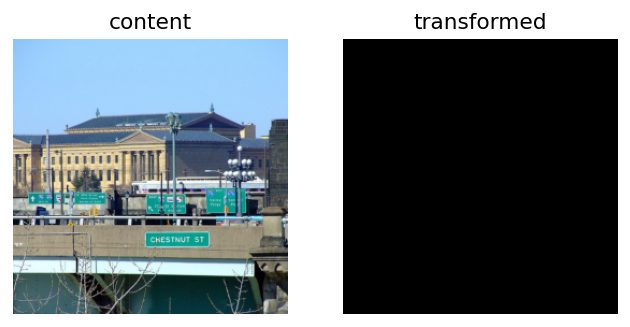

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_0.png
> Batch 501/29572
>>> Content Loss:	1860521.50
>>> Style Loss:	7164413.30
>>> Total Loss:	9024934.68
> Time used:	131.37792563438416 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_500.pth


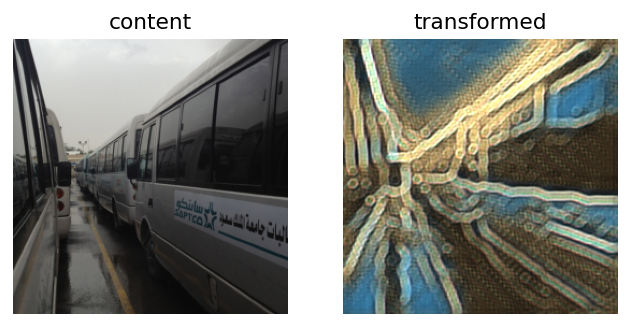

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_500.png
> Batch 1001/29572
>>> Content Loss:	1768507.88
>>> Style Loss:	4090654.01
>>> Total Loss:	5859162.54
> Time used:	261.2987003326416 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_1000.pth


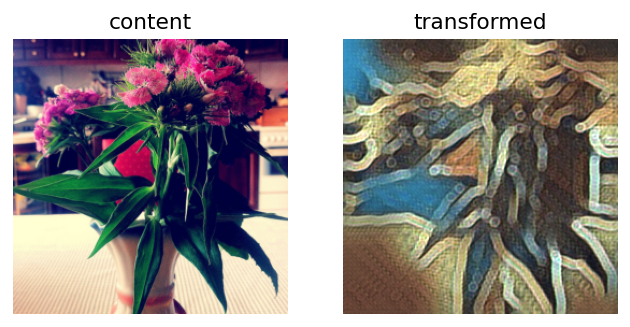

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_1000.png
> Batch 1501/29572
>>> Content Loss:	1666882.00
>>> Style Loss:	2994787.46
>>> Total Loss:	4661670.35
> Time used:	393.0009868144989 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_1500.pth


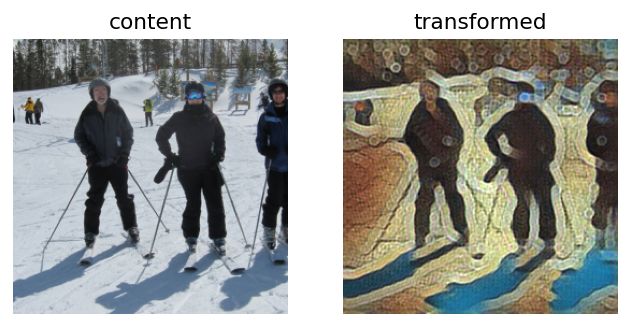

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_1500.png
> Batch 2001/29572
>>> Content Loss:	1569954.00
>>> Style Loss:	2420875.98
>>> Total Loss:	3990830.46
> Time used:	525.3674447536469 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_2000.pth


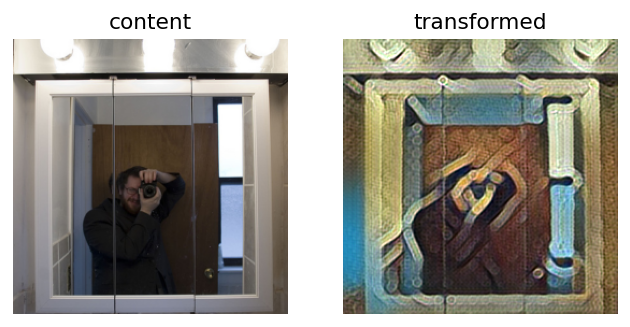

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_2000.png
> Batch 2501/29572
>>> Content Loss:	1483421.25
>>> Style Loss:	2064480.32
>>> Total Loss:	3547901.31
> Time used:	657.3160488605499 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_2500.pth


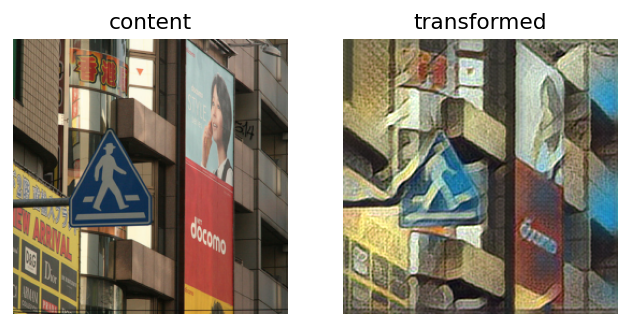

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_2500.png
> Batch 3001/29572
>>> Content Loss:	1408244.88
>>> Style Loss:	1818606.15
>>> Total Loss:	3226850.22
> Time used:	789.1324682235718 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_3000.pth


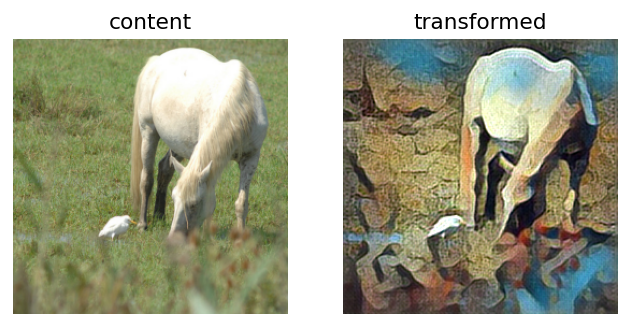

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_3000.png
> Batch 3501/29572
>>> Content Loss:	1346107.12
>>> Style Loss:	1639018.32
>>> Total Loss:	2985122.92
> Time used:	919.4566833972931 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_3500.pth


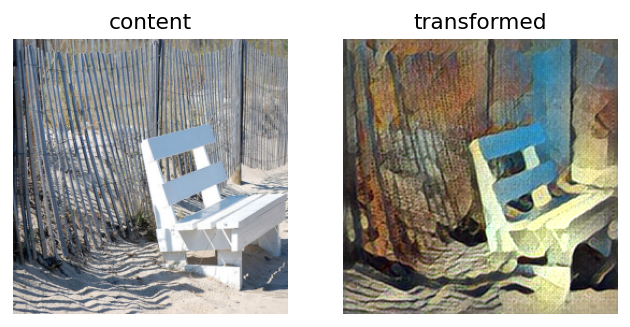

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_3500.png
> Batch 4001/29572
>>> Content Loss:	1295065.75
>>> Style Loss:	1502094.80
>>> Total Loss:	2797157.33
> Time used:	1049.4599854946136 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_4000.pth


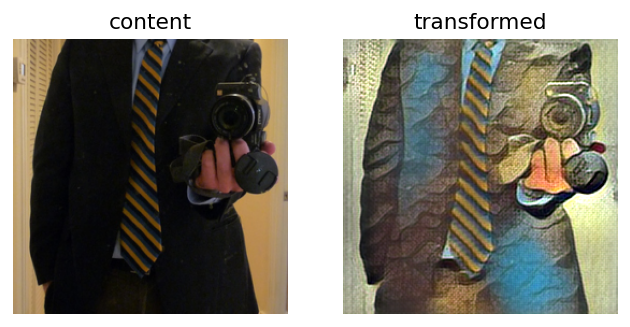

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_4000.png
> Batch 4501/29572
>>> Content Loss:	1252682.62
>>> Style Loss:	1393411.94
>>> Total Loss:	2646091.82
> Time used:	1179.1797864437103 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_4500.pth


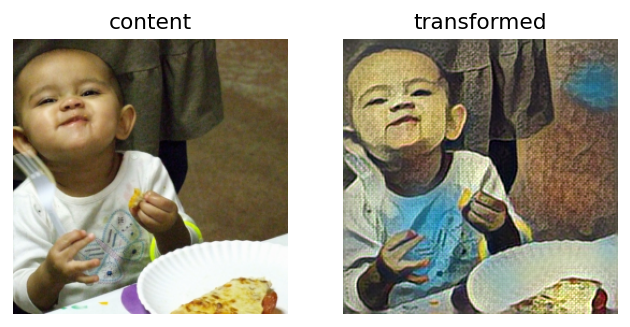

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_4500.png
> Batch 5001/29572
>>> Content Loss:	1215898.12
>>> Style Loss:	1305597.78
>>> Total Loss:	2521493.58
> Time used:	1308.5389394760132 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_5000.pth


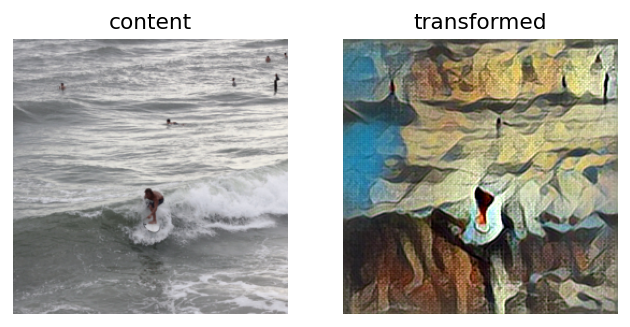

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_5000.png
> Batch 5501/29572
>>> Content Loss:	1183537.12
>>> Style Loss:	1232263.54
>>> Total Loss:	2415797.94
> Time used:	1438.1571521759033 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_5500.pth


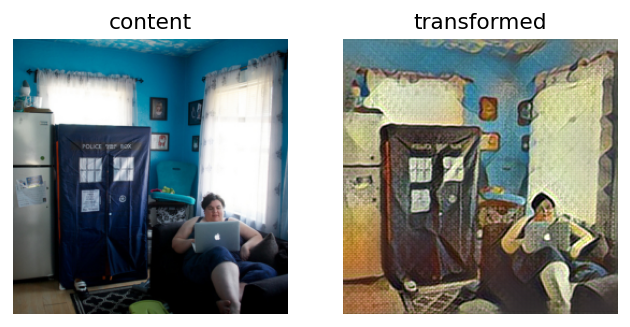

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_5500.png
> Batch 6001/29572
>>> Content Loss:	1156340.25
>>> Style Loss:	1170272.83
>>> Total Loss:	2326610.62
> Time used:	1567.8476855754852 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_6000.pth


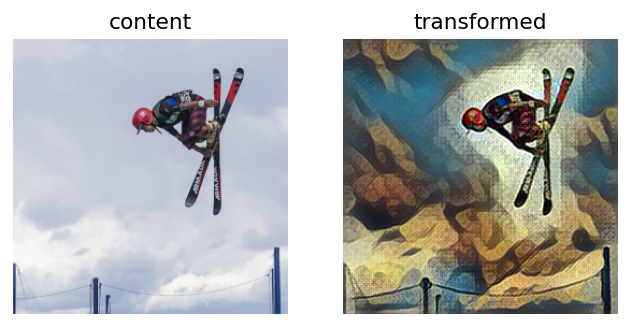

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_6000.png
> Batch 6501/29572
>>> Content Loss:	1131543.38
>>> Style Loss:	1116899.04
>>> Total Loss:	2248440.82
> Time used:	1697.1814036369324 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_6500.pth


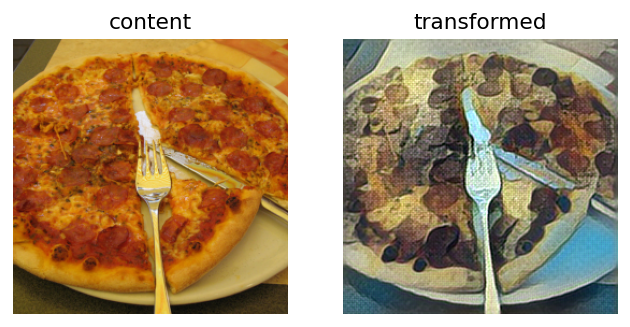

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_6500.png
> Batch 7001/29572
>>> Content Loss:	1110074.88
>>> Style Loss:	1070468.17
>>> Total Loss:	2180542.49
> Time used:	1826.9005465507507 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_7000.pth


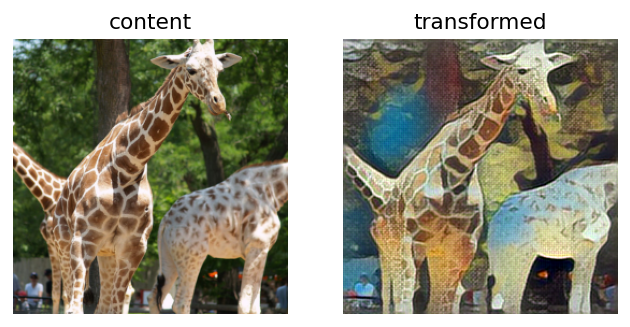

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_7000.png
> Batch 7501/29572
>>> Content Loss:	1090965.00
>>> Style Loss:	1030298.21
>>> Total Loss:	2121261.94
> Time used:	1956.6531796455383 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_7500.pth


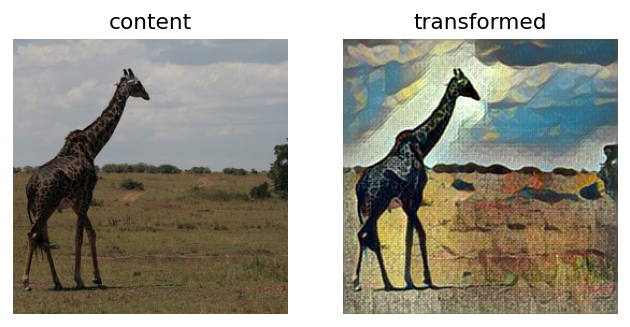

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_7500.png
> Batch 8001/29572
>>> Content Loss:	1073536.50
>>> Style Loss:	994214.74
>>> Total Loss:	2067749.63
> Time used:	2085.9172291755676 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_8000.pth


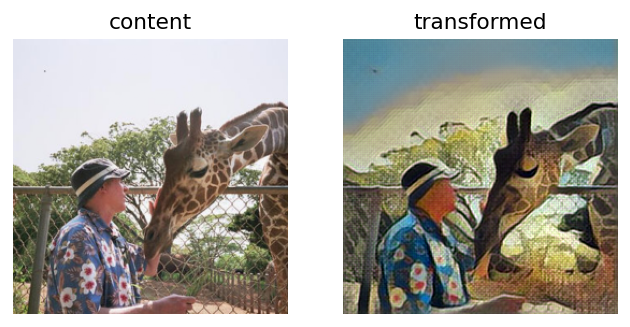

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_8000.png
> Batch 8501/29572
>>> Content Loss:	1058041.50
>>> Style Loss:	962319.99
>>> Total Loss:	2020359.45
> Time used:	2215.516085624695 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_8500.pth


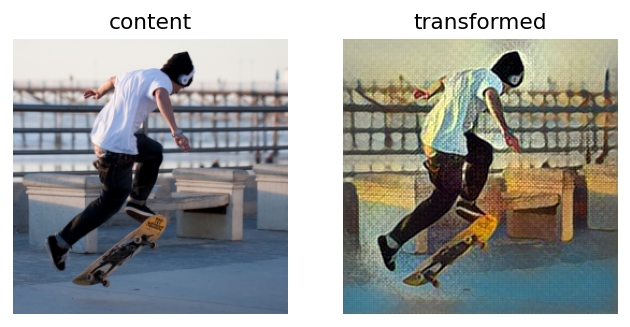

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_8500.png
> Batch 9001/29572
>>> Content Loss:	1044055.19
>>> Style Loss:	934469.28
>>> Total Loss:	1978522.62
> Time used:	2345.159611940384 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_9000.pth


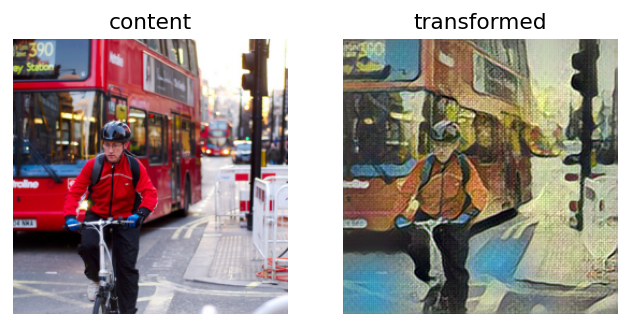

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_9000.png
> Batch 9501/29572
>>> Content Loss:	1031503.25
>>> Style Loss:	908724.99
>>> Total Loss:	1940226.32
> Time used:	2474.4400067329407 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_9500.pth


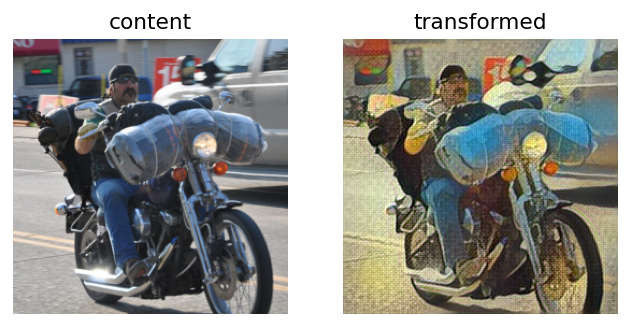

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_9500.png
> Batch 10001/29572
>>> Content Loss:	1019589.94
>>> Style Loss:	884891.44
>>> Total Loss:	1904480.48
> Time used:	2604.0697407722473 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_10000.pth


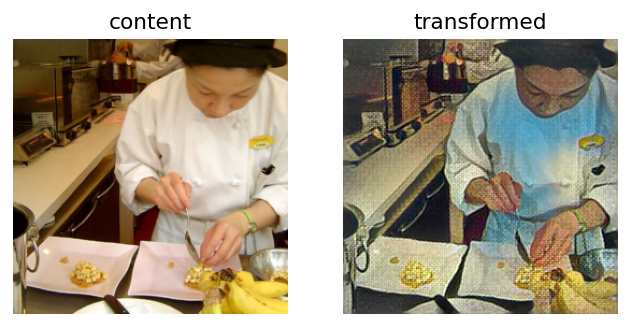

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_10000.png
> Batch 10501/29572
>>> Content Loss:	1008634.75
>>> Style Loss:	863029.05
>>> Total Loss:	1871663.28
> Time used:	2734.034003019333 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_10500.pth


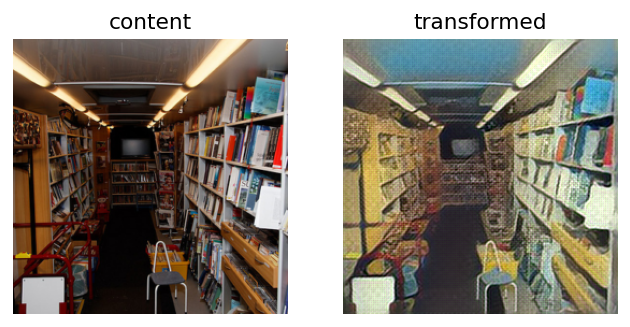

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_10500.png
> Batch 11001/29572
>>> Content Loss:	998406.75
>>> Style Loss:	842967.03
>>> Total Loss:	1841372.74
> Time used:	2863.464674949646 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_11000.pth


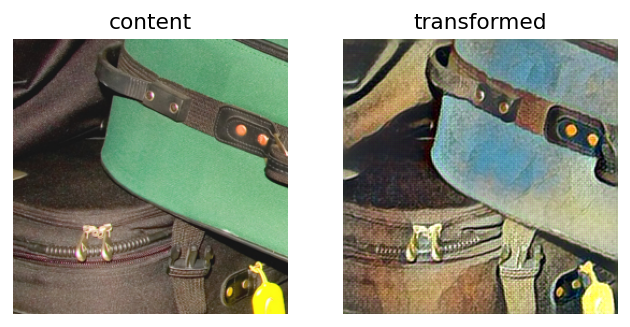

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_11000.png
> Batch 11501/29572
>>> Content Loss:	988855.06
>>> Style Loss:	824562.00
>>> Total Loss:	1813415.57
> Time used:	2993.1649758815765 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_11500.pth


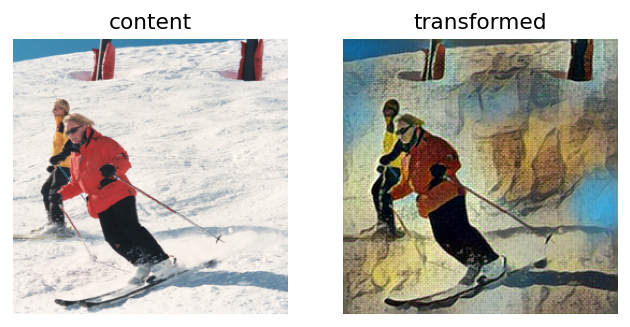

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_11500.png
> Batch 12001/29572
>>> Content Loss:	979845.25
>>> Style Loss:	807432.32
>>> Total Loss:	1787275.71
> Time used:	3122.8239674568176 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_12000.pth


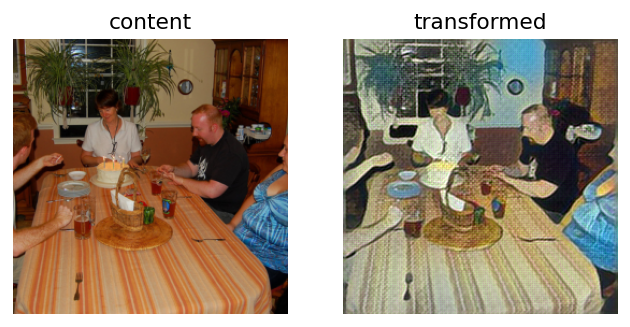

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_12000.png
> Batch 12501/29572
>>> Content Loss:	971425.75
>>> Style Loss:	791475.68
>>> Total Loss:	1762899.49
> Time used:	3252.1878502368927 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_12500.pth


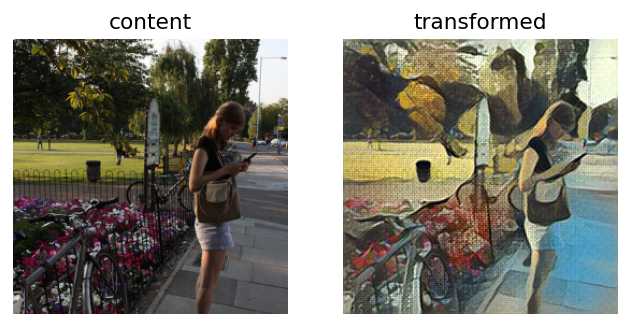

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_12500.png
> Batch 13001/29572
>>> Content Loss:	963605.50
>>> Style Loss:	776673.95
>>> Total Loss:	1740277.40
> Time used:	3381.802029132843 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_13000.pth


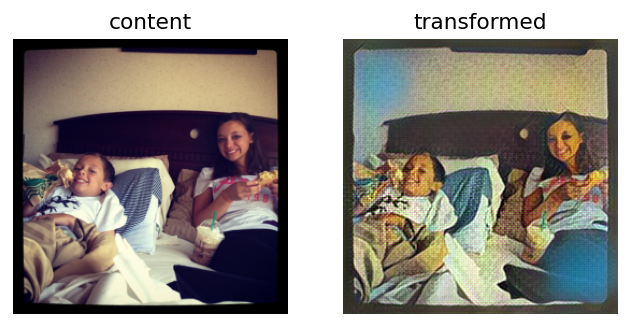

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_13000.png
> Batch 13501/29572
>>> Content Loss:	956601.56
>>> Style Loss:	762807.46
>>> Total Loss:	1719407.80
> Time used:	3511.448545217514 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_13500.pth


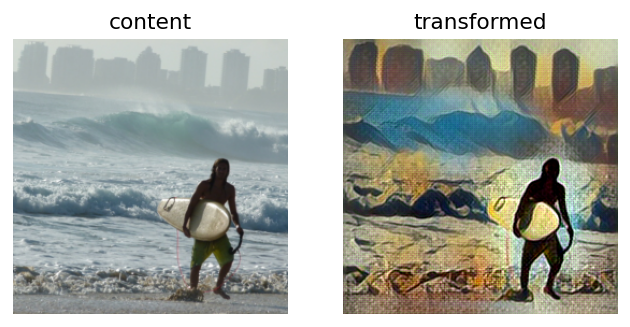

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_13500.png
> Batch 14001/29572
>>> Content Loss:	949690.25
>>> Style Loss:	749915.34
>>> Total Loss:	1699604.47
> Time used:	3640.790801525116 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_14000.pth


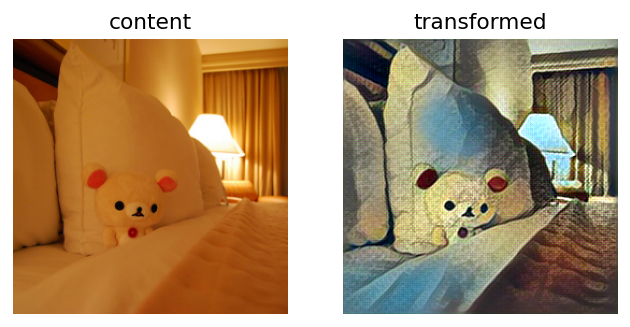

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_14000.png
> Batch 14501/29572
>>> Content Loss:	943181.00
>>> Style Loss:	737705.02
>>> Total Loss:	1680885.29
> Time used:	3770.4322457313538 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_14500.pth


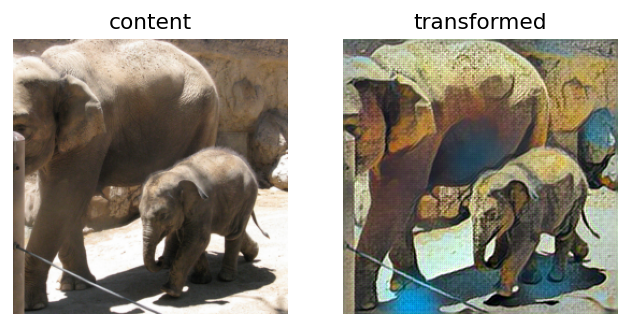

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_14500.png
> Batch 15001/29572
>>> Content Loss:	936859.12
>>> Style Loss:	726251.33
>>> Total Loss:	1663109.43
> Time used:	3900.0866656303406 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_15000.pth


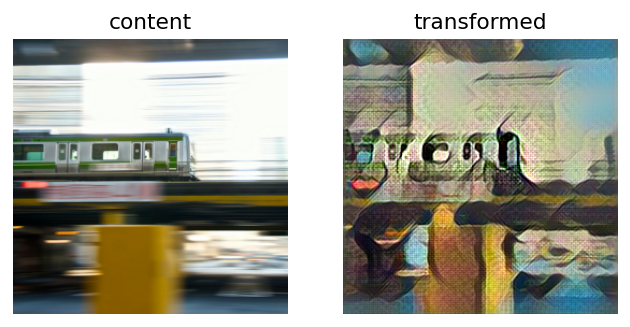

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_15000.png
> Batch 15501/29572
>>> Content Loss:	931123.25
>>> Style Loss:	715472.20
>>> Total Loss:	1646594.47
> Time used:	4029.3336005210876 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_15500.pth


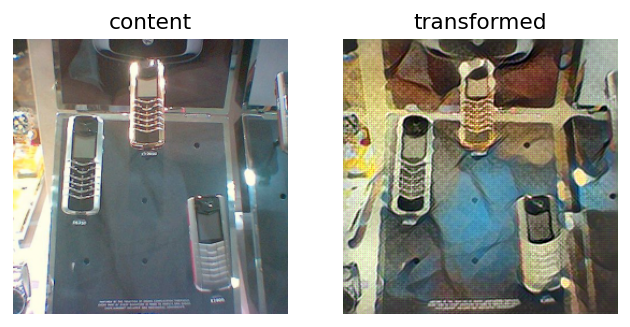

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_15500.png
> Batch 16001/29572
>>> Content Loss:	925423.81
>>> Style Loss:	705208.24
>>> Total Loss:	1630631.62
> Time used:	4158.875106334686 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_16000.pth


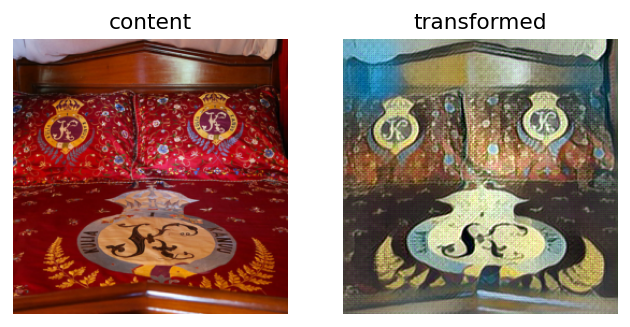

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_16000.png
> Batch 16501/29572
>>> Content Loss:	920185.94
>>> Style Loss:	695550.19
>>> Total Loss:	1615736.04
> Time used:	4288.5724947452545 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_16500.pth


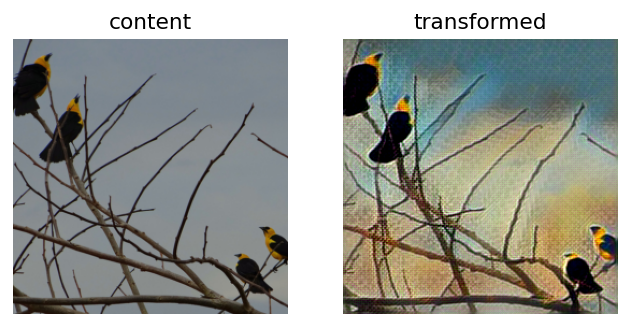

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_16500.png
> Batch 17001/29572
>>> Content Loss:	915117.62
>>> Style Loss:	686324.78
>>> Total Loss:	1601442.46
> Time used:	4417.896666765213 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_17000.pth


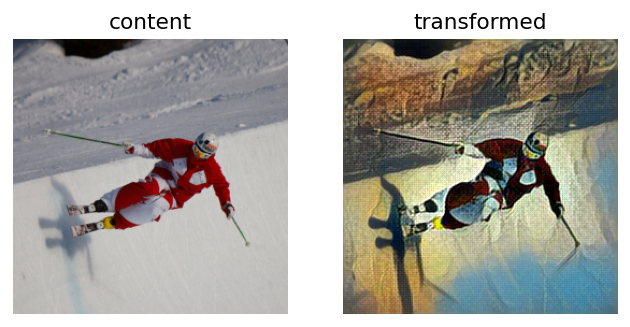

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_17000.png
> Batch 17501/29572
>>> Content Loss:	910158.44
>>> Style Loss:	677603.26
>>> Total Loss:	1587762.13
> Time used:	4547.436301469803 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_17500.pth


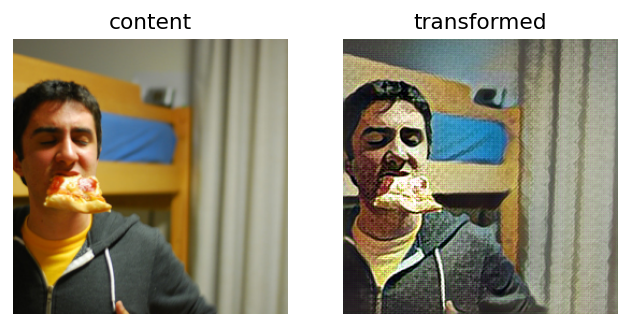

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_17500.png
> Batch 18001/29572
>>> Content Loss:	905766.62
>>> Style Loss:	669438.59
>>> Total Loss:	1575205.35
> Time used:	4677.1402423381805 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_18000.pth


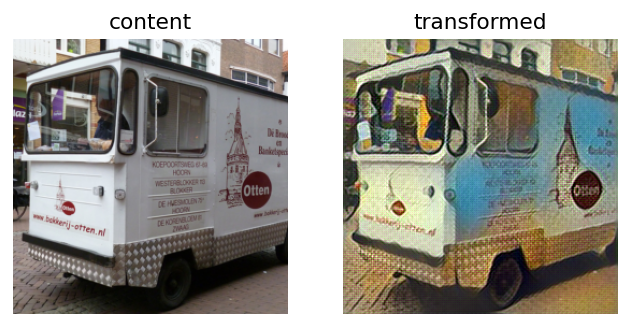

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_18000.png
> Batch 18501/29572
>>> Content Loss:	901349.88
>>> Style Loss:	661501.27
>>> Total Loss:	1562851.13
> Time used:	4806.403001070023 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_18500.pth


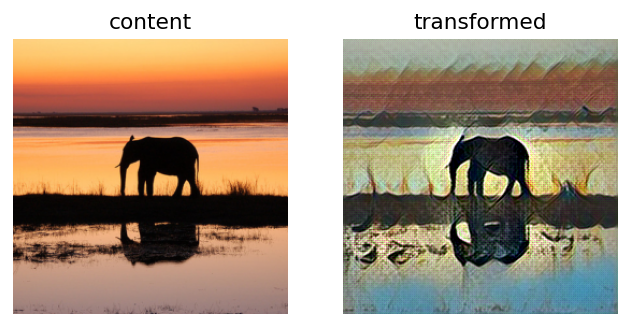

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_18500.png
> Batch 19001/29572
>>> Content Loss:	896993.88
>>> Style Loss:	653937.29
>>> Total Loss:	1550931.04
> Time used:	4935.889138221741 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_19000.pth


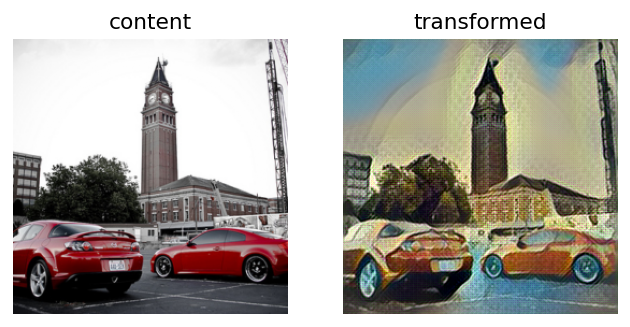

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_19000.png
> Batch 19501/29572
>>> Content Loss:	892898.81
>>> Style Loss:	646747.52
>>> Total Loss:	1539645.94
> Time used:	5065.386013746262 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_19500.pth


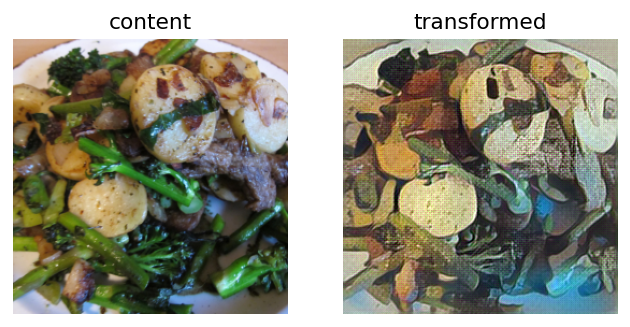

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_19500.png
> Batch 20001/29572
>>> Content Loss:	889094.44
>>> Style Loss:	639849.89
>>> Total Loss:	1528943.13
> Time used:	5194.718519687653 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_20000.pth


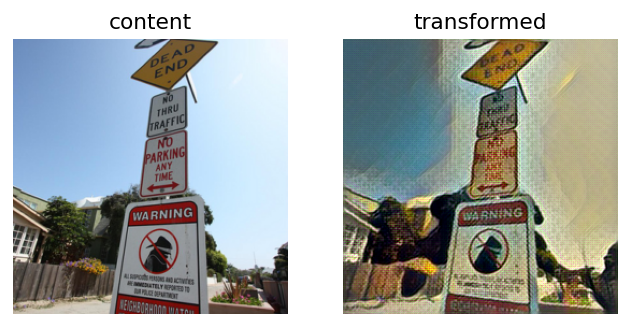

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_20000.png
> Batch 20501/29572
>>> Content Loss:	885315.56
>>> Style Loss:	633286.95
>>> Total Loss:	1518601.90
> Time used:	5324.295113801956 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_20500.pth


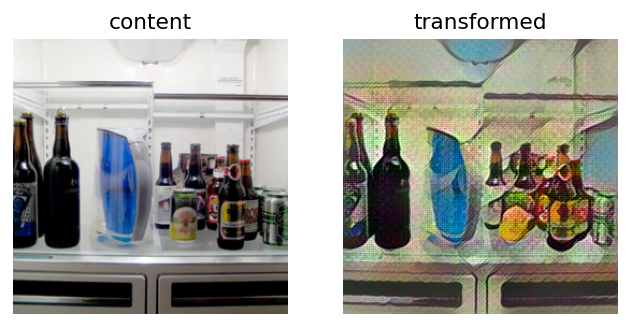

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_20500.png
> Batch 21001/29572
>>> Content Loss:	881715.62
>>> Style Loss:	626879.25
>>> Total Loss:	1508592.98
> Time used:	5454.0933294296265 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_21000.pth


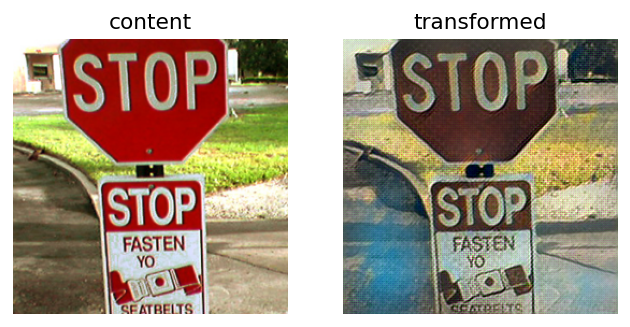

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_21000.png
> Batch 21501/29572
>>> Content Loss:	878452.44
>>> Style Loss:	620935.68
>>> Total Loss:	1499387.49
> Time used:	5583.404375553131 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_21500.pth


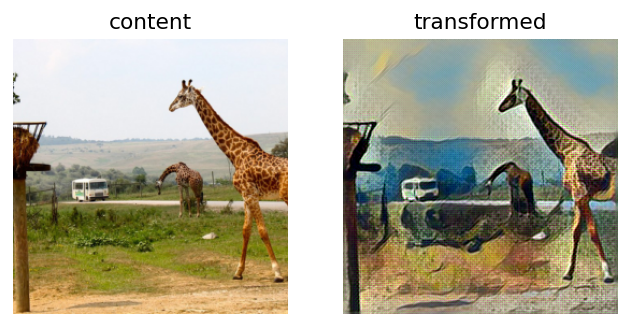

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_21500.png
> Batch 22001/29572
>>> Content Loss:	875026.75
>>> Style Loss:	615051.57
>>> Total Loss:	1490078.26
> Time used:	5713.115208387375 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_22000.pth


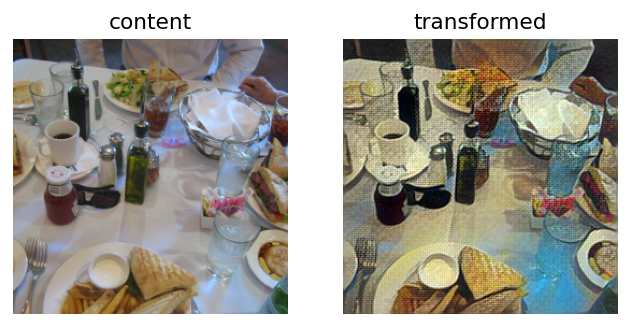

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_22000.png
> Batch 22501/29572
>>> Content Loss:	871791.88
>>> Style Loss:	609474.35
>>> Total Loss:	1481266.78
> Time used:	5842.707936048508 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_22500.pth


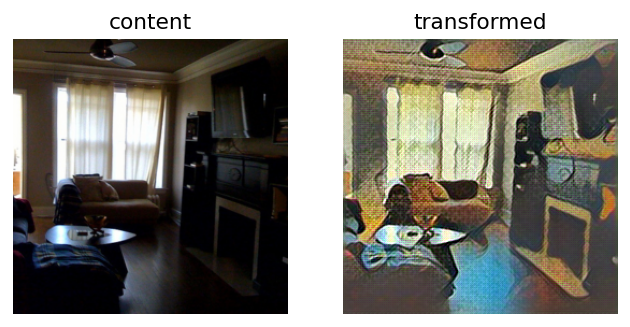

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_22500.png
> Batch 23001/29572
>>> Content Loss:	868659.81
>>> Style Loss:	604106.80
>>> Total Loss:	1472765.85
> Time used:	5972.074540615082 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_23000.pth


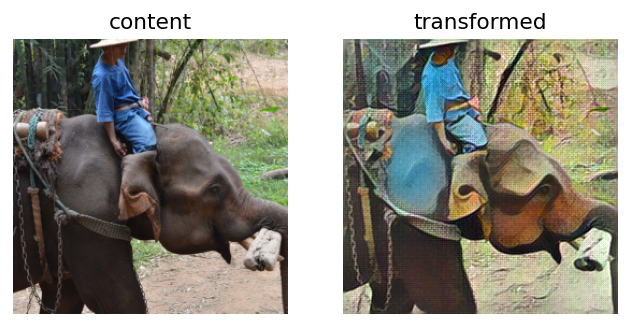

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_23000.png
> Batch 23501/29572
>>> Content Loss:	865875.56
>>> Style Loss:	598963.26
>>> Total Loss:	1464838.41
> Time used:	6101.7704355716705 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_23500.pth


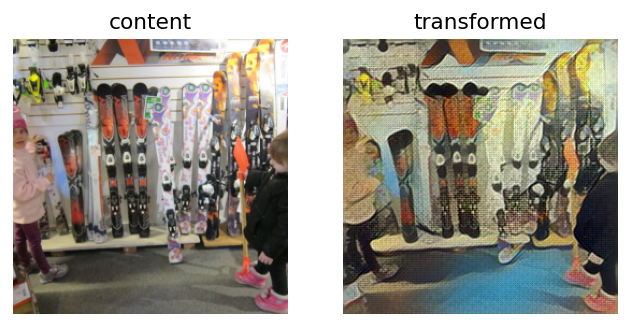

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_23500.png
> Batch 24001/29572
>>> Content Loss:	863106.12
>>> Style Loss:	593967.38
>>> Total Loss:	1457072.67
> Time used:	6231.497268676758 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_24000.pth


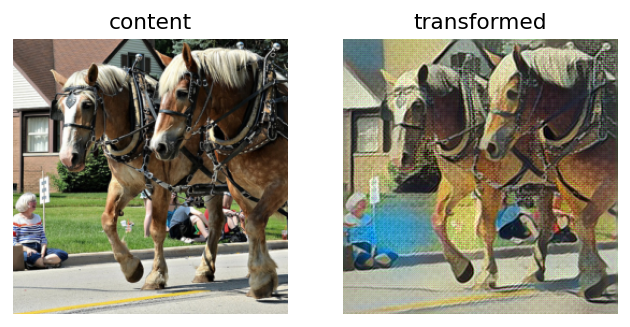

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_24000.png
> Batch 24501/29572
>>> Content Loss:	860292.38
>>> Style Loss:	589146.26
>>> Total Loss:	1449438.04
> Time used:	6360.883796215057 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_24500.pth


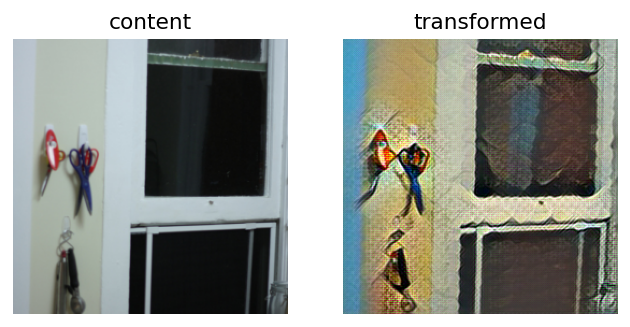

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_24500.png
> Batch 25001/29572
>>> Content Loss:	857568.44
>>> Style Loss:	584511.55
>>> Total Loss:	1442078.24
> Time used:	6490.814724445343 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_25000.pth


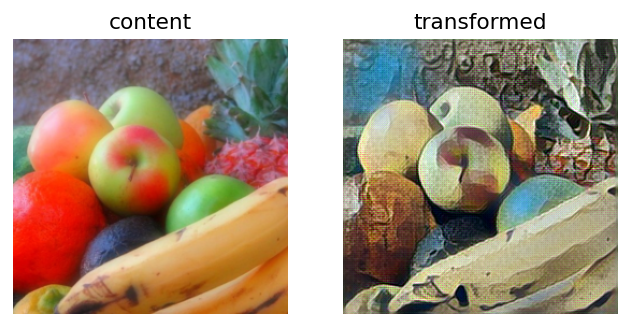

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_25000.png
> Batch 25501/29572
>>> Content Loss:	855012.56
>>> Style Loss:	580026.99
>>> Total Loss:	1435037.42
> Time used:	6620.618999481201 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_25500.pth


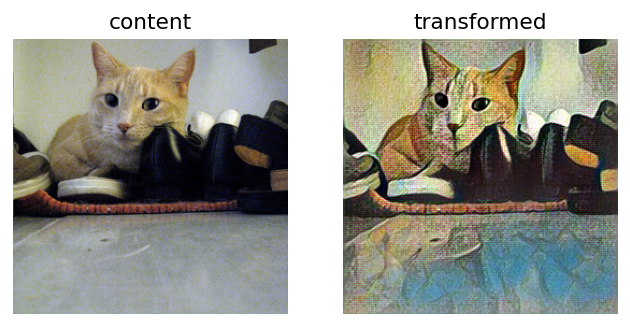

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_25500.png
> Batch 26001/29572
>>> Content Loss:	852600.81
>>> Style Loss:	575688.52
>>> Total Loss:	1428287.18
> Time used:	6749.991497516632 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_26000.pth


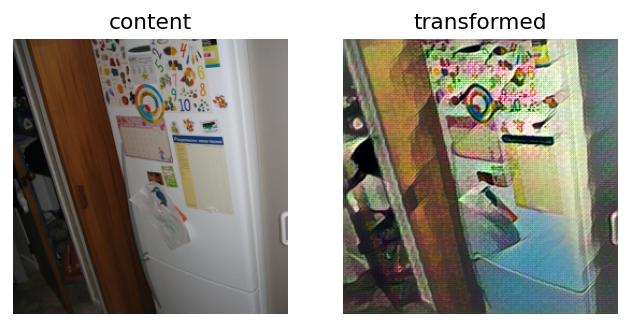

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_26000.png
> Batch 26501/29572
>>> Content Loss:	850329.38
>>> Style Loss:	571517.56
>>> Total Loss:	1421845.37
> Time used:	6879.663294553757 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_26500.pth


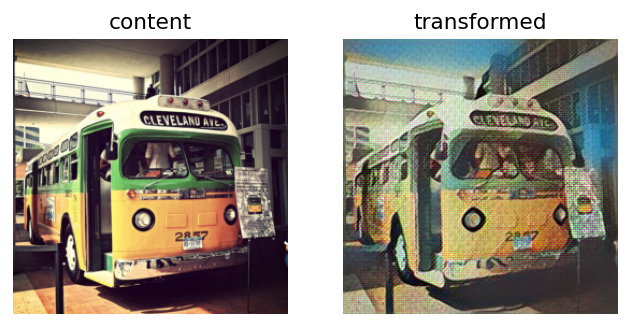

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_26500.png
> Batch 27001/29572
>>> Content Loss:	848135.81
>>> Style Loss:	567423.04
>>> Total Loss:	1415557.94
> Time used:	7009.38782954216 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_27000.pth


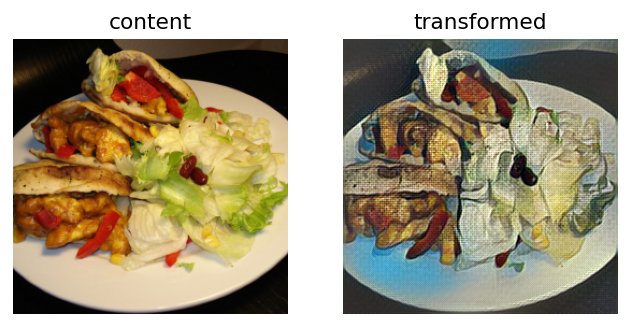

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_27000.png
> Batch 27501/29572
>>> Content Loss:	845802.94
>>> Style Loss:	563496.34
>>> Total Loss:	1409299.63
> Time used:	7138.798080444336 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_27500.pth


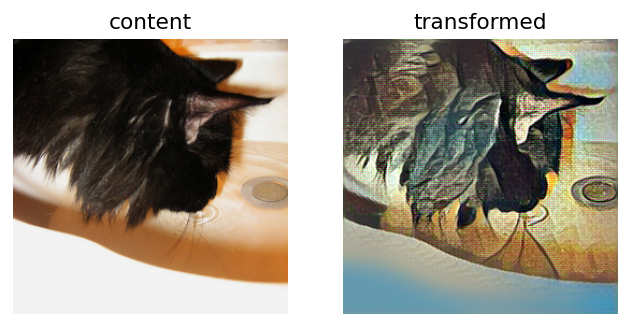

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_27500.png
> Batch 28001/29572
>>> Content Loss:	843658.75
>>> Style Loss:	559669.75
>>> Total Loss:	1403327.83
> Time used:	7268.434195995331 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_28000.pth


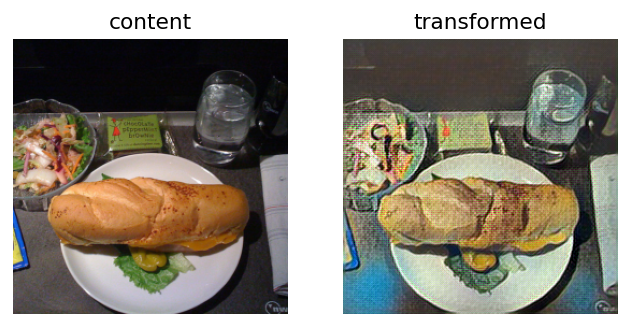

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_28000.png
> Batch 28501/29572
>>> Content Loss:	841440.88
>>> Style Loss:	555955.24
>>> Total Loss:	1397395.87
> Time used:	7398.151686906815 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_28500.pth


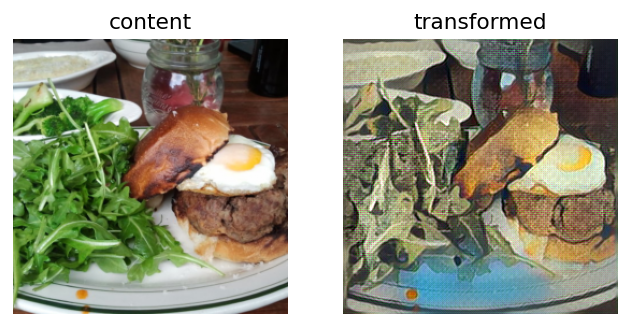

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_28500.png
> Batch 29001/29572
>>> Content Loss:	839313.12
>>> Style Loss:	552366.76
>>> Total Loss:	1391680.08
> Time used:	7527.45849609375 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_29000.pth


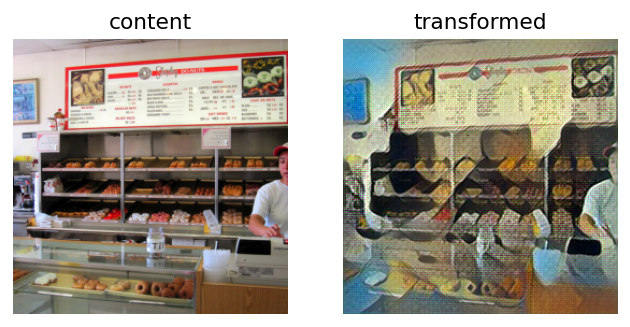

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_29000.png
> Batch 29501/29572
>>> Content Loss:	837241.50
>>> Style Loss:	548864.77
>>> Total Loss:	1386106.82
> Time used:	7657.187907457352 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_29500.pth


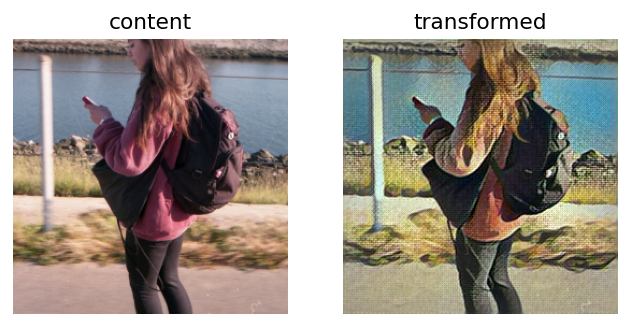

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_29500.png
> Batch 29572/29572
>>> Content Loss:	836942.00
>>> Style Loss:	548390.05
>>> Total Loss:	1385332.48
> Time used:	7675.933446407318 seconds
Model checkpoint saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_29571.pth


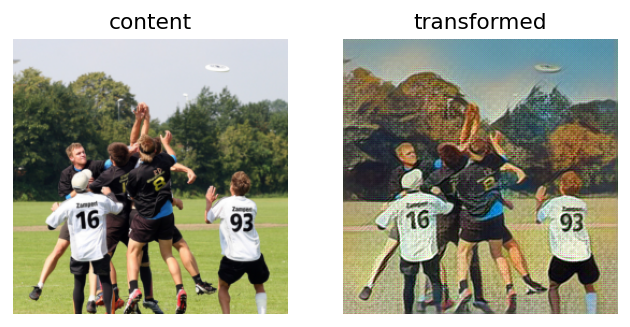

Image sample saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/image_checkpoints/miro_image_29571.png
END OF TRAINING


Last model saved at /content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_weights.pth

Time used for training: 7676.182595491409 sec

Content loss history: [51669324.0, 9024934.675648702, 5859162.537962038, 4661670.348517654, 3990830.4599575214, 3547901.307277089, 3226850.219551816, 2985122.9190588403, 2797157.3298550365, 2646091.815763164, 2521493.5817336533, 2415797.9433966554, 2326610.6195425764, 2248440.819431626, 2180542.488028496, 2121261.9433992133, 2067749.633178665, 2020359.4479693566, 1978522.6156746473, 1940226.3204202189, 1904480.4761336367, 1871663.2848657272, 1841372.7407224344, 1813415.5684397009, 1787275.7136488627, 1762899.4922906167, 1740277.4006422583, 1719407.7995333679, 1699604.4741938077, 1680885.2871741604, 1663109.4291338911, 1646594.47259451, 163063

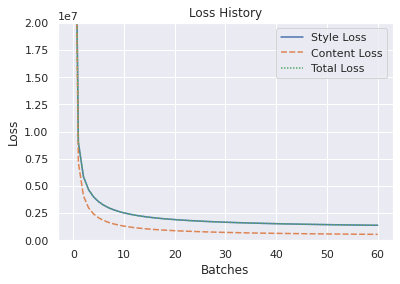

In [ ]:
def train(style_image_path, style_name,
          print_loss_history=True, plot_loss_history=True):

    print(f"The style to learn: {style_name}\n")

    # Prepare directories for checkpoints
    time_id = f"{datetime.now().strftime('%Y%m%d')}_{int(time.time())}"
    checkpoint_saving_dir = os.path.join(ROOT, CHECKPOINT_DIR, f'{style_name}_{time_id}')
    os.makedirs(checkpoint_saving_dir)
    model_checkpoint_saving_dir = os.path.join(checkpoint_saving_dir, 'model_checkpoints')
    image_checkpoint_saving_dir = os.path.join(checkpoint_saving_dir, 'image_checkpoints')
    os.makedirs(model_checkpoint_saving_dir)
    os.makedirs(image_checkpoint_saving_dir)

    # Dataset and Dataloader
    transform = transforms.Compose([
        transforms.Resize(TRAIN_IMAGE_SIZE),
        transforms.CenterCrop(TRAIN_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])
    train_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=TRAIN_BATCH_SIZE, shuffle=True)

    # TransformerNet
    net = TransformerNet()
    if CONTINUE_FROM_PREVIOUS_WEIGHTS:
        net.load_state_dict(torch.load(PREVIOUS_WEIGHTS_PATH))
    net = net.to(device)

    optimizer = optim.Adam(net.parameters(), lr=ADAM_LR)
    mse_loss = nn.MSELoss().to(device)

    # Pretrained loss network
    loss_net = VGG16().to(device)

    # Get Style Features
    imagenet_neg_mean = torch.tensor([-103.939, -116.779, -123.68], dtype=torch.float32).reshape(1,3,1,1).to(device)
    style_image = load_image(style_image_path)
    style_tensor = itot(style_image).to(device)
    style_tensor = style_tensor.add(imagenet_neg_mean)
    B, C, H, W = style_tensor.shape
    style_features = loss_net(style_tensor.expand([TRAIN_BATCH_SIZE, C, H, W]))
    style_gram = {}
    for key, value in style_features.items():
        style_gram[key] = gram_matrix(value)

    # Loss trackers
    content_loss_history = []
    style_loss_history = []
    total_loss_history = []
    batch_content_loss_sum = 0
    batch_style_loss_sum = 0
    batch_total_loss_sum = 0

    # Optimization/Training Loop
    batch_count = 1
    start_time = time.time()
    for epoch in range(NUM_EPOCHS):
        print(f"Epoch {epoch}:")
        for content_batch, _ in train_loader:
            # Get current batch size in case of odd batch sizes
            curr_batch_size = content_batch.shape[0]

            torch.cuda.empty_cache()
            optimizer.zero_grad()

            # Generate images and get features
            content_batch = content_batch[:,[2,1,0]].to(device)
            generated_batch = net(content_batch)
            content_features = loss_net(content_batch.add(imagenet_neg_mean))
            generated_features = loss_net(generated_batch.add(imagenet_neg_mean))

            # Content loss
            content_loss = CONTENT_WEIGHT * mse_loss(generated_features['relu2_2'], content_features['relu2_2'])            
            batch_content_loss_sum += content_loss

            # Style loss
            style_loss = 0
            for key, value in generated_features.items():
                s_loss = mse_loss(gram_matrix(value), style_gram[key][:curr_batch_size])
                style_loss += s_loss
            style_loss *= STYLE_WEIGHT
            batch_style_loss_sum += style_loss.item()

            # Total loss
            total_loss = content_loss + style_loss
            batch_total_loss_sum += total_loss.item()

            # Backprop and step
            total_loss.backward()
            optimizer.step()

            # Show loss and checkpoint models
            if (((batch_count-1)%SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*len(train_loader))):
                print(f"> Batch {batch_count}/{NUM_EPOCHS*len(train_loader)}")
                print(">>> Content Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
                print(">>> Style Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
                print(">>> Total Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
                print("> Time used:\t{} seconds".format(time.time()-start_time))

                model_checkpoint_path_gdrive = os.path.join(model_checkpoint_saving_dir, 
                                                            f"{style_name}_checkpoint_{str(batch_count-1)}.pth")
                torch.save(net.state_dict(), model_checkpoint_path_gdrive)
                print(f"Model checkpoint saved at {model_checkpoint_path_gdrive}")

                # Show image comparison
                content_sample_tensor = content_batch[0].clone().detach().unsqueeze(dim=0)
                content_sample_image = ttoi(content_sample_tensor.clone().detach())
                transformed_sample_tensor = generated_batch[0].clone().detach().unsqueeze(dim=0)
                transformed_sample_image = ttoi(transformed_sample_tensor.clone().detach())
                show_images_side_by_side(content_sample_image, transformed_sample_image, 'content', 'transformed')
                # Save transformed image at checkpoint
                transformed_sample_image_path_gdrive = os.path.join(image_checkpoint_saving_dir, 
                                                        f"{style_name}_image_{str(batch_count-1)}.png")
                save_image(transformed_sample_image, transformed_sample_image_path_gdrive)
                print(f"Image sample saved at {transformed_sample_image_path_gdrive}")

                # Track loss histories
                content_loss_history.append(batch_total_loss_sum/batch_count)
                style_loss_history.append(batch_style_loss_sum/batch_count)
                total_loss_history.append(batch_total_loss_sum/batch_count)

            # Count
            batch_count+=1

    end_time = time.time()
    print("END OF TRAINING\n\n")

    # Save TransformerNet weights
    net.eval()
    net.cpu()
    last_model_path_gdrive = os.path.join(model_checkpoint_saving_dir, f"{style_name}_weights.pth")
    torch.save(net.state_dict(), last_model_path_gdrive)
    print(f"Last model saved at {last_model_path_gdrive}\n")

    print(f"Time used for training: {end_time-start_time} sec\n")

    # Show loss history
    if print_loss_history: 
        print("Content loss history:", content_loss_history)
        print("Style loss history:", style_loss_history)
        print("Total loss history:", total_loss_history)

    # Plot loss history
    if plot_loss_history:
        plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)

    all_loss_history = [content_loss_history, style_loss_history, total_loss_history]
    return net, all_loss_history


if MODE == 'TRAIN':
    style_name = get_style_name(STYLE_IMAGE_NAME)
    style_image_path = os.path.join(ROOT, STYLE_IMAGE_DIR, STYLE_IMAGE_NAME)
    _, all_loss_history = train(style_image_path, 
                                style_name,
                                print_loss_history=True, 
                                plot_loss_history=True)

## **Section 7: Image Style Transfer Pipeline**

Steps to run *image style transfer*:
1. Properly modify configs (Section 1) and run it
    - Remember to set `MODE = 'IMAGE'`
2. Run everything Section 2, 3, and 4
4. Run `image_style_transfer` (the cell below)

Time Used: 1.6745991706848145 sec


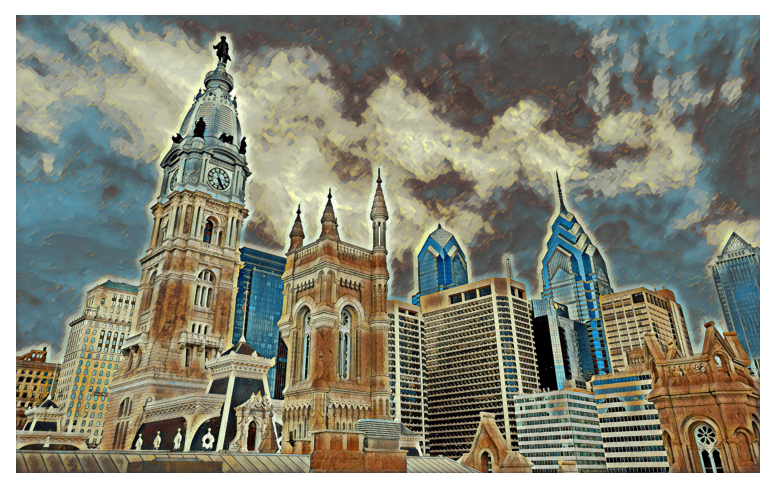

In [ ]:
@torch.no_grad()
def image_style_transfer(content_image_path):
    # Load content image
    content_image = load_image(content_image_path)

    # Load Transformer Network and its weights
    net = TransformerNet()
    style_weights = os.path.join(ROOT, TRANSFORMATIONS_DIR, TRANSFORMATION_WEIGHTS)
    net.load_state_dict(torch.load(style_weights))
    # net.load_state_dict(torch.load('/content/drive/MyDrive/style_transfer/training_checkpoints/miro_20221126_1669505400/model_checkpoints/miro_checkpoint_29571.pth',map_location=torch.device('cpu')))
    net = net.to(device)

    garbage_collect()

    # Style transfer
    start = time.time()
    content_tensor = itot(content_image).to(device)
    stylized_tensor = net(content_tensor)
    stylized_image = ttoi(stylized_tensor.detach())
    end = time.time()
    print(f"Time Used: {end - start} sec")
    
    show_image(stylized_image)

    time_id = f"{datetime.now().strftime('%Y%m%d')}_{int(time.time())}"
    result_saving_path = os.path.join(ROOT, RESULT_IMAGE_DIR, f"{RESULT_IMAGE_NAME}_{time_id}.jpg")
    save_image(stylized_image, result_saving_path)


if MODE == 'IMAGE':
    content_image_path = os.path.join(ROOT, CONTENT_IMAGE_DIR, CONTENT_IMAGE_NAME)
    image_style_transfer(content_image_path)

## **Section 8: Batch Image Style Transfer**

This is a helper function called in video style transfer.

In [ ]:
def batch_image_style_transfer(extracted_frames_dataset_dir, transformed_frames_saving_dir, batch_size=1):
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])
    frame_dataset = ImageFolderWithPaths(extracted_frames_dataset_dir, transform=transform)
    image_loader = torch.utils.data.DataLoader(frame_dataset, batch_size=batch_size)

    net = TransformerNet()
    style_weights = os.path.join(ROOT, TRANSFORMATIONS_DIR, TRANSFORMATION_WEIGHTS)
    net.load_state_dict(torch.load(style_weights))
    net = net.to(device)

    # Batch transform
    with torch.no_grad():
        for content_batch, _, path in image_loader:
            torch.cuda.empty_cache()

            # Transform frame
            transformed_tensor = net(content_batch.to(device)).detach()

            # Save transformed frames
            for i in range(len(path)):
                transformed_frame = ttoi(transformed_tensor[i])
                frame_name = os.path.basename(path[i])
                frame_saving_path = os.path.join(transformed_frames_saving_dir, frame_name)
                save_image(transformed_frame, frame_saving_path)

## **Section 9: Video Style Transfer Pipeline**

Steps to run *video style transfer*:
1. Properly modify configs (Section 1) and run it
    - Remember to set `MODE = 'VIDEO'`
2. Run everything Section 2, 3, and 4
3. Run Section 8
4. Run `video_style_transfer` (the cell below)

In [ ]:
def video_style_transfer(video_path):
    start_time = time.time()

    # Save frames in video in a directory
    extract_video_frames(video_path)
    
    # Batch transform frames
    batch_image_style_transfer(CONTENT_FRAMES_DATASET_DIR, STYLE_FRAMES_SAVING_PATH, batch_size=BATCH_SIZE)

    # Get specs of the video
    height, width, fps = extract_video_specs(video_path)

    # Combine all the transfromed frames into a video
    time_id = f"{datetime.now().strftime('%Y%m%d')}_{int(time.time())}"
    result_saving_path = os.path.join(ROOT, RESULT_VIDEO_DIR, f"{RESULT_VIDEO_NAME}_{time_id}.mp4")
    create_video(STYLE_FRAMES_SAVING_PATH, result_saving_path, fps, int(height), int(width))

    end_time = time.time()
    print(f"Time used: {end_time-start_time}")


if MODE == 'VIDEO':
    content_video_path = os.path.join(ROOT, CONTENT_VIDEO_DIR, CONTENT_VIDEO_NAME)
    video_style_transfer(content_video_path)

Content video frames extracted => Number of frames: 313
Video specs extracted => width: 1920.0 height: 1080.0 fps: 29.97605746209098
Video saved at /content/drive/MyDrive/style_transfer/videos/result_videos/lishui_miro_transformed_20221127_1669514656.mp4
Time used: 180.63638377189636
